# V11 Training Monitor

This notebook monitors the training metrics of the currently running IndraV11 experiment.


In [375]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
import time
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import make_interp_spline


from IPython.display import clear_output


sns.set_theme(style="darkgrid")

In [376]:
def get_latest_run_metrics():
    # Find the latest run folder
    runs_dir = "../runs"
    if not os.path.exists(runs_dir):
        print("No runs directory found.")
        return None

    # Get all subdirectories
    run_paths = [
        os.path.join(runs_dir, d)
        for d in os.listdir(runs_dir)
        if os.path.isdir(os.path.join(runs_dir, d))
    ]
    if not run_paths:
        print("No runs found.")
        return None

    # Sort by time
    run_paths.sort(key=os.path.getmtime, reverse=True)
    latest_run = run_paths[0]

    metrics_file = os.path.join(latest_run, "metrics.csv")
    if not os.path.exists(metrics_file):
        print(f"No metrics.csv found in {latest_run}")
        return None

    print(f"Monitoring: {latest_run}")
    try:
        df = pd.read_csv(metrics_file)
        return df
    except Exception as e:
        print(f"Error reading CSV: {e}")
        return None


df = get_latest_run_metrics()

Monitoring: ../runs\IndraV11-GPUDistill-Llama_20251219-130308


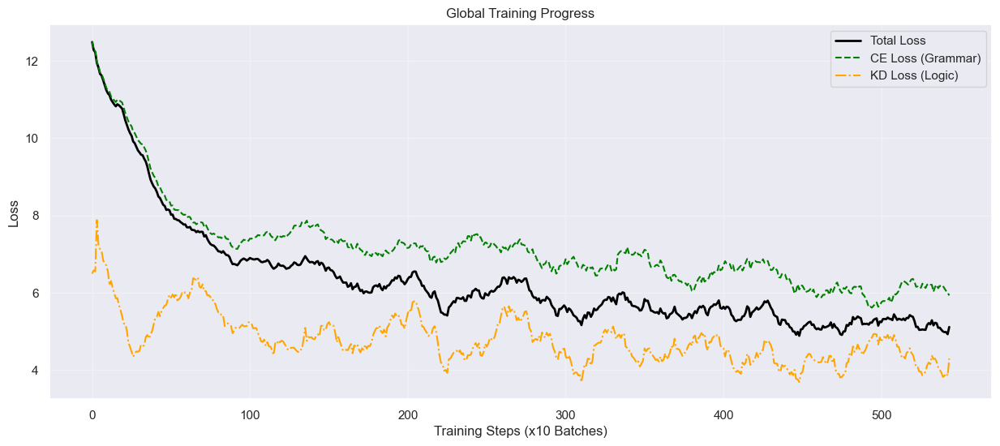

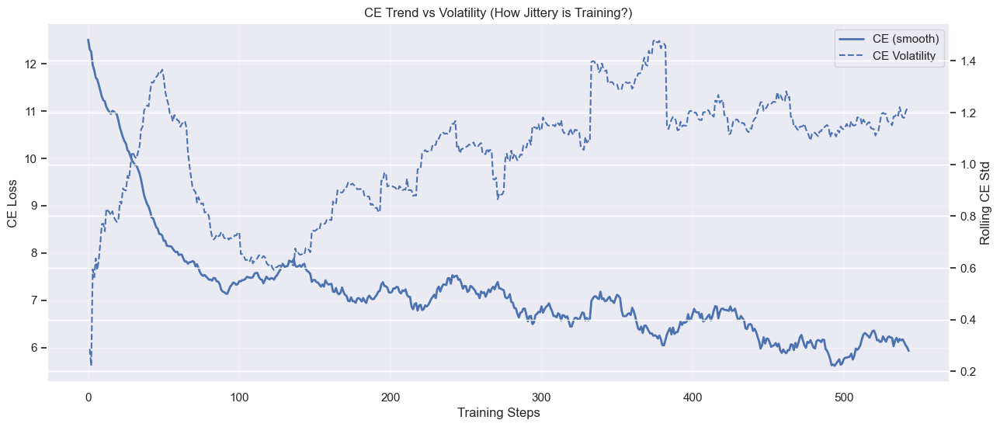

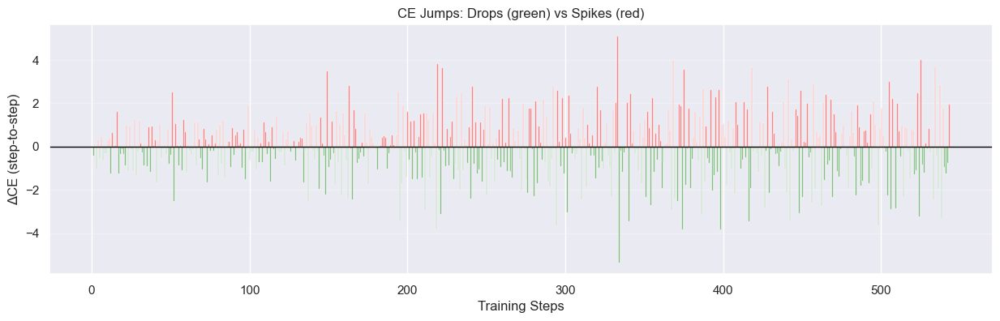

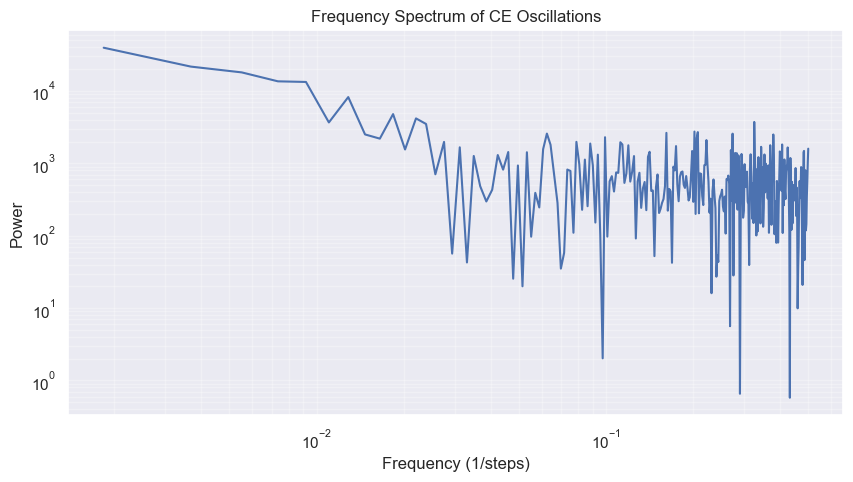

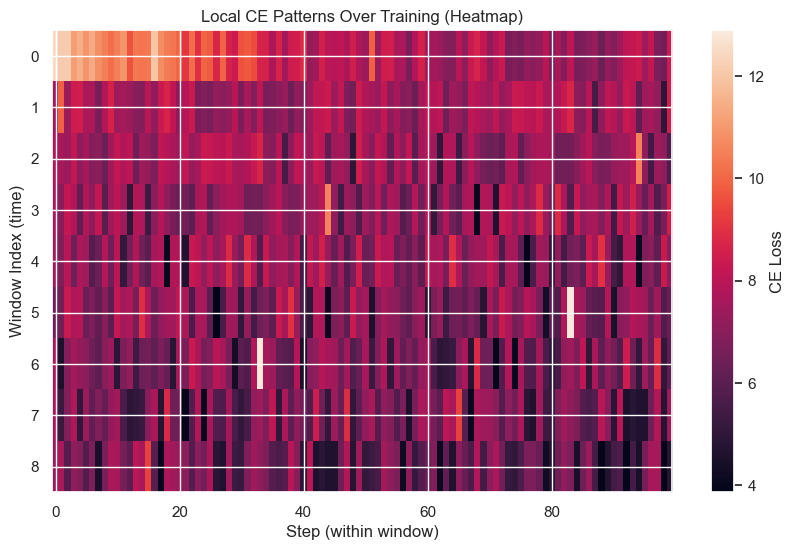

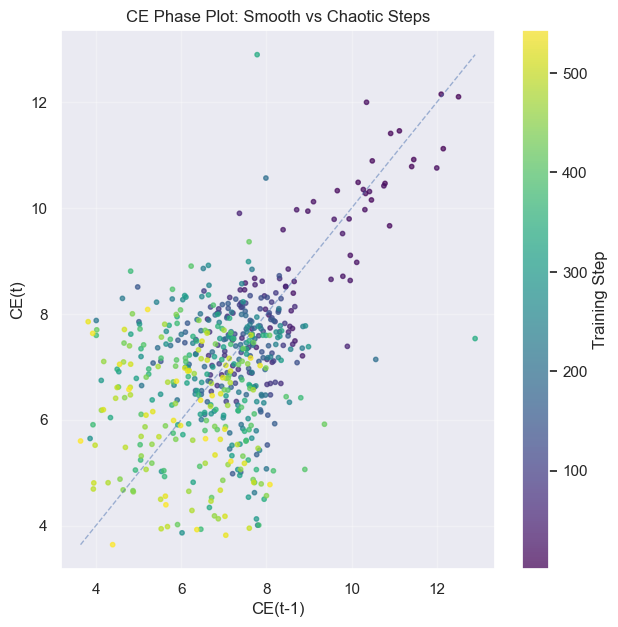

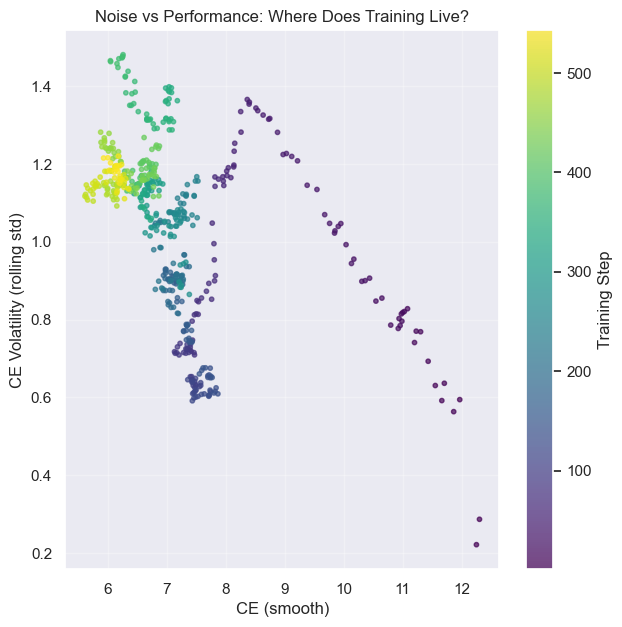

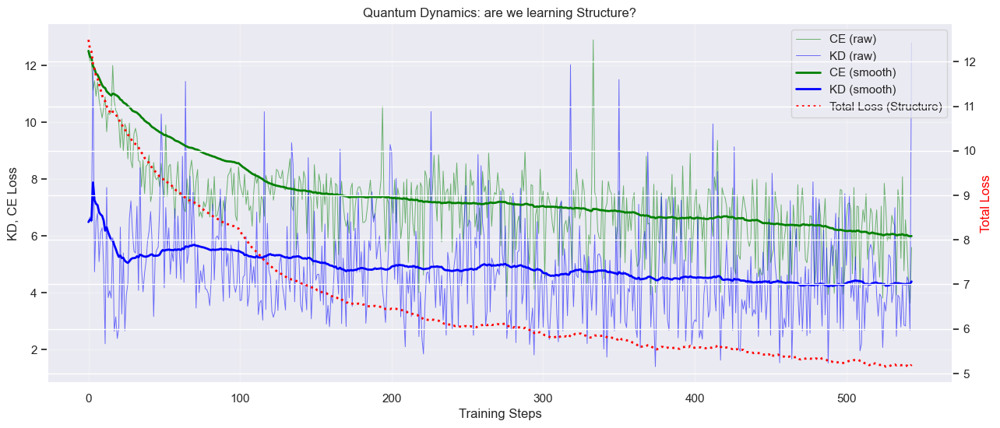

In [377]:
window = 20
# Smoothing
df["Total_Smooth"] = df["total_loss"].rolling(window, min_periods=1).mean()
df["CE_Smooth"] = df["ce_loss"].rolling(window, min_periods=1).mean()
df["KD_Smooth"] = df["kd_loss"].rolling(window, min_periods=1).mean()

plt.figure(figsize=(15, 6))
plt.plot(df["Total_Smooth"], label="Total Loss", color="black", linewidth=2)
plt.plot(df["CE_Smooth"], label="CE Loss (Grammar)", color="green", linestyle="--")
plt.plot(df["KD_Smooth"], label="KD Loss (Logic)", color="orange", linestyle="-.")
plt.xlabel("Training Steps (x10 Batches)")
plt.ylabel("Loss")
plt.title("Global Training Progress")
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


vol_window = 50  # or 100, depends on step count

df["CE_Smooth"] = df["ce_loss"].rolling(window, min_periods=1).mean()
df["CE_Vol"] = df["ce_loss"].rolling(vol_window, min_periods=1).std()

fig, ax1 = plt.subplots(figsize=(15, 6))

# CE smooth (main path)
ax1.plot(df.index, df["CE_Smooth"], label="CE (smooth)", linewidth=2)
ax1.set_xlabel("Training Steps")
ax1.set_ylabel("CE Loss")
ax1.grid(True, alpha=0.3)

# Volatility on second axis
ax2 = ax1.twinx()
ax2.plot(df.index, df["CE_Vol"], label="CE Volatility", linestyle="--", linewidth=1.5)
ax2.set_ylabel("Rolling CE Std")

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc="upper right")

plt.title("CE Trend vs Volatility (How Jittery is Training?)")
plt.show()


df["CE_Delta"] = df["ce_loss"].diff()

fig, ax = plt.subplots(figsize=(15, 4))

colors = ["green" if d < 0 else "red" for d in df["CE_Delta"].fillna(0)]
ax.bar(df.index, df["CE_Delta"], color=colors, alpha=0.6)
ax.axhline(0, color="black", linewidth=1)

ax.set_xlabel("Training Steps")
ax.set_ylabel("ΔCE (step-to-step)")
ax.set_title("CE Jumps: Drops (green) vs Spikes (red)")
ax.grid(True, axis="y", alpha=0.3)

plt.show()


ce = df["ce_loss"].values
ce_centered = ce - ce.mean()

freqs = np.fft.rfftfreq(len(ce_centered), d=1.0)  # d=1 step per index
power = np.abs(np.fft.rfft(ce_centered)) ** 2

plt.figure(figsize=(10, 5))
plt.loglog(freqs[1:], power[1:])  # skip 0 freq
plt.xlabel("Frequency (1/steps)")
plt.ylabel("Power")
plt.title("Frequency Spectrum of CE Oscillations")
plt.grid(True, which="both", alpha=0.3)
plt.show()

window = 100
stride = 50
if len(df) > window:
    windows = []
    for start in range(0, len(df) - window + 1, stride):
        segment = df["ce_loss"].iloc[start : start + window].values
        windows.append(segment)

    heat = np.array(windows)

    if heat.size > 0 and len(heat.shape) == 2:

        plt.figure(figsize=(10, 6))
        plt.imshow(heat, aspect="auto", interpolation="nearest")
        plt.colorbar(label="CE Loss")
        plt.xlabel("Step (within window)")
        plt.ylabel("Window Index (time)")
        plt.title("Local CE Patterns Over Training (Heatmap)")
        plt.show()
    else:
        print("Not enough data segments for heatmap.")

else:
    print(f"Not enough data for heatmap (Available: {len(df)}, Required: {window})")

if "Batch_Index" not in df.columns:
    df["Batch_Index"] = np.arange(len(df))

df["CE_prev"] = df["ce_loss"].shift(1)

valid = df.dropna(subset=["ce_loss", "CE_prev"])

plt.figure(figsize=(7, 7))
sc = plt.scatter(
    valid["CE_prev"],
    valid["ce_loss"],
    c=valid["Batch_Index"],
    cmap="viridis",
    s=10,
    alpha=0.7,
)
plt.colorbar(sc, label="Training Step")
plt.plot(
    [valid["CE_prev"].min(), valid["CE_prev"].max()],
    [valid["CE_prev"].min(), valid["CE_prev"].max()],
    linestyle="--",
    linewidth=1,
    alpha=0.5,
)

plt.xlabel("CE(t-1)")
plt.ylabel("CE(t)")
plt.title("CE Phase Plot: Smooth vs Chaotic Steps")
plt.grid(True, alpha=0.3)
plt.show()


# Left side = good loss; right side = bad loss.

# Low y = calm; high y = jittery.

# Ideally points move from (high CE, high vol) → (low CE, low vol).
# If they move to (low CE, high vol) and circle there, you know you’re in the “good but noisy” regime where an LR cooldown or different schedule could buy you stability.

plt.figure(figsize=(7, 7))
sc = plt.scatter(
    df["CE_Smooth"],
    df["CE_Vol"],
    c=df["Batch_Index"],  # or df.index
    cmap="viridis",
    s=10,
    alpha=0.7,
)
plt.colorbar(sc, label="Training Step")

plt.xlabel("CE (smooth)")
plt.ylabel("CE Volatility (rolling std)")
plt.title("Noise vs Performance: Where Does Training Live?")
plt.grid(True, alpha=0.3)
plt.show()


df["CE_Smooth"] = df["ce_loss"].rolling(window, min_periods=1).mean()
df["KD_Smooth"] = df["kd_loss"].rolling(window, min_periods=1).mean()
df["Total_Smooth"] = df["total_loss"].rolling(window, min_periods=1).mean()
df["Batch_Index"] = df.index

# --- PLOT 2A: QUANTUM LOSS CURVES ---
fig, ax1 = plt.subplots(figsize=(15, 6))
# ax1.plot(df["CE_Smooth"], label="CE Loss", color="green", alpha=0.5)
# ax1.plot(
#     df["Mag_Smooth"], label="Mag Loss (Confidence)", color="blue", linewidth=2
# )
# ax1.set_xlabel("Training Steps")
# ax1.set_ylabel("Msg/CE Loss")
# ax1.grid(True, alpha=0.3)

# 1) RAW (noisy) curves in lighter color / thinner line
ax1.plot(df["ce_loss"], label="CE (raw)", color="green", alpha=0.55, linewidth=0.7)
ax1.plot(df["kd_loss"], label="KD (raw)", color="blue", alpha=0.55, linewidth=0.7)

# 2) SMOOTH curves bold on top
ax1.plot(df["CE_Smooth"], label="CE (smooth)", color="green", linewidth=2)
ax1.plot(df["KD_Smooth"], label="KD (smooth)", color="blue", linewidth=2)

ax1.set_xlabel("Training Steps")
ax1.set_ylabel("KD, CE Loss")
ax1.grid(True, alpha=0.3)

ax2 = ax1.twinx()
ax2.plot(
    df["Total_Smooth"],
    label="Total Loss (Structure)",
    color="red",
    linestyle=":",
    linewidth=2,
)
ax2.set_ylabel("Total Loss", color="red")

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc="upper right")
plt.title("Quantum Dynamics: are we learning Structure?")
plt.show()

Loading 3D Data from: ../runs\IndraV11-GPUDistill-Llama_20251219-130308\metrics.csv


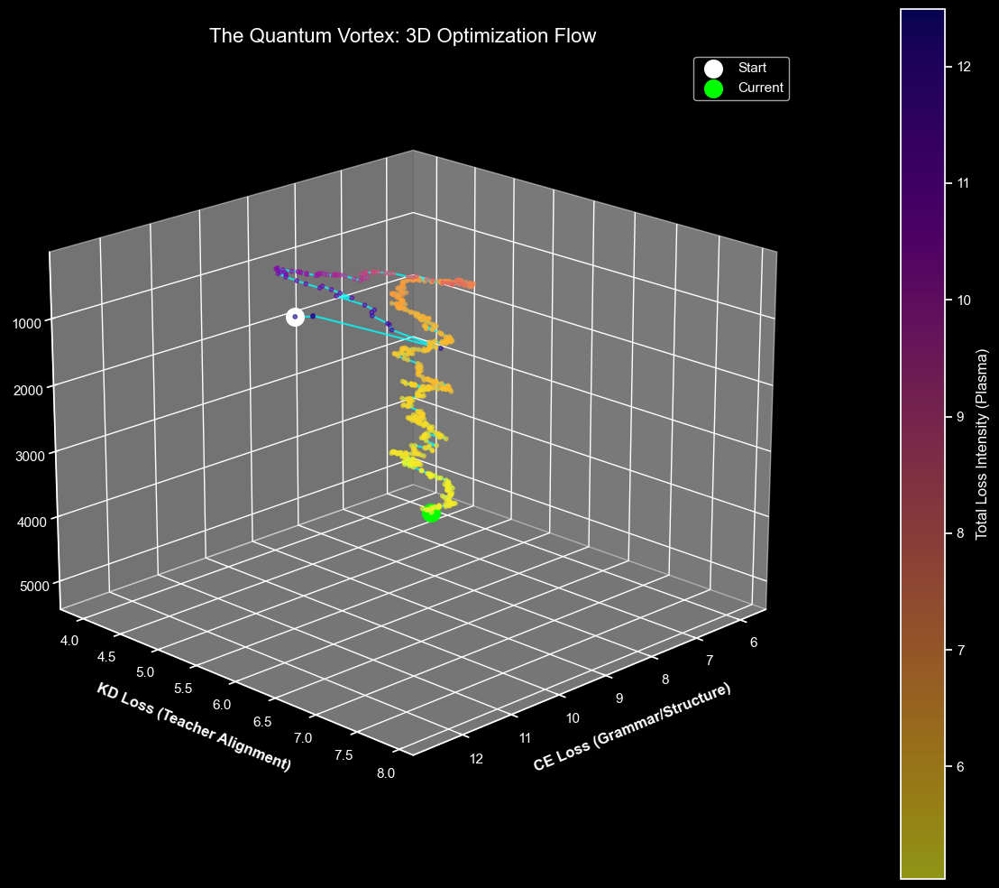

In [378]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import glob
import os
import numpy as np

# --- 1. AUTO-RELOAD DATA ---
files = glob.glob("runs/*/metrics.csv") + glob.glob("../runs/*/metrics.csv")
if files:
    latest_file = max(files, key=os.path.getmtime)
    print(f"Loading 3D Data from: {latest_file}")
    df = pd.read_csv(latest_file)

# --- 2. DATA PREP ---
# We smooth the data to see the "Flow" instead of the "Noise"
window = 50
df["ce_smooth"] = df["ce_loss"].rolling(window=window, min_periods=1).mean()
df["kd_smooth"] = df["kd_loss"].rolling(window=window, min_periods=1).mean()
df["total_smooth"] = df["total_loss"].rolling(window=window, min_periods=1).mean()

# --- 3. 3D PLOT ---
plt.style.use("dark_background")  # Quantum Style
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection="3d")

# Data coords
xs = df["ce_smooth"]
ys = df["kd_smooth"]
zs = df["step"]

# Color by Total Loss (Hot = High Loss, Cool = Low Loss)
scatter = ax.scatter(xs, ys, zs, c=df["total_smooth"], cmap="plasma_r", s=10, alpha=0.6)

# Add a "Flow Line" to show the trajectory clearly
ax.plot(xs, ys, zs, color="cyan", linewidth=1.5, alpha=0.8)

# Highlight Start and End
ax.scatter(xs.iloc[0], ys.iloc[0], zs.iloc[0], color="white", s=200, label="Start")
ax.scatter(xs.iloc[-1], ys.iloc[-1], zs.iloc[-1], color="lime", s=200, label="Current")

# Labels
ax.set_xlabel("CE Loss (Grammar/Structure)", fontweight="bold", labelpad=10)
ax.set_ylabel("KD Loss (Teacher Alignment)", fontweight="bold", labelpad=10)
ax.set_zlabel("Training Steps", fontweight="bold", labelpad=10)

# Invert Z axis so "Time" goes deeper into the pit?
# Or keep standard: Step 0 at bottom?
# Let's keep Step 0 at Top (Inverted Z) to look like a "Descent"
ax.set_zlim(zs.max(), zs.min())

# View Angle
ax.view_init(elev=20, azim=45)

fig.colorbar(scatter, ax=ax, label="Total Loss Intensity (Plasma)", pad=0.1)
plt.title("The Quantum Vortex: 3D Optimization Flow", fontsize=16, color="white")
plt.legend()
plt.tight_layout()
plt.show()

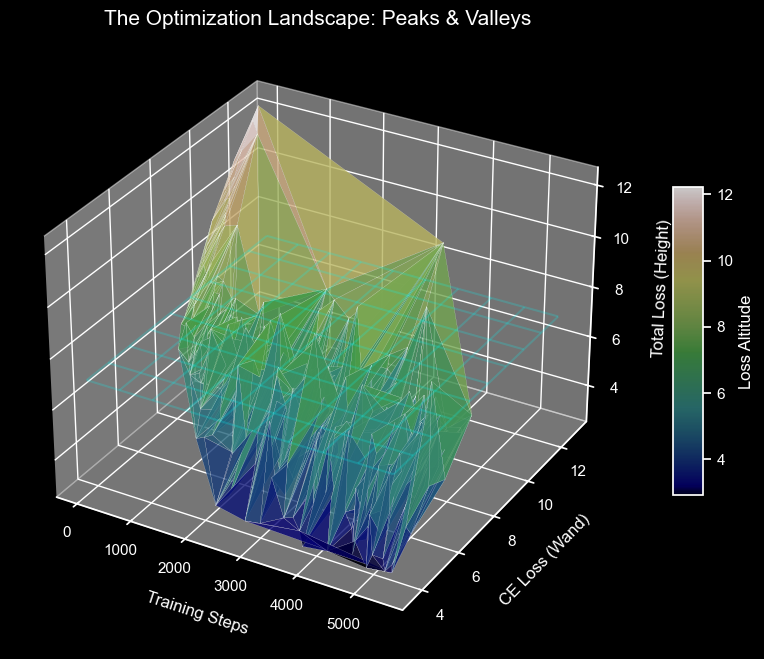

In [379]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import glob
import os
import matplotlib.tri as mtri

# --- AUTO-LOAD ---
files = glob.glob("runs/*/metrics.csv") + glob.glob("../runs/*/metrics.csv")
if files:
    latest = max(files, key=os.path.getmtime)
    df = pd.read_csv(latest)

# --- 3D LANDSCAPE CONFIG ---
plt.style.use("dark_background")
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection="3d")

# Data Construction
# X: Step (Time journey)
# Y: CE Loss (The "Width" of the valley)
# Z: Total Loss (The "Height" of the peaks)
x = df["step"]
y = df["ce_loss"]
z = df["total_loss"]

# Create the Surface (Triangulation)
# This connects your data points into a continuous mountain range
surf = ax.plot_trisurf(
    x, y, z, cmap="gist_earth", linewidth=0.1, antialiased=True, alpha=0.8
)

# Add "Water Level" (Goal Plane)
import numpy as np

xx, yy = np.meshgrid(
    np.linspace(x.min(), x.max(), 10), np.linspace(y.min(), y.max(), 10)
)
zz = np.zeros_like(xx) + 7.0  # The "Water Level" at Loss 7.0
ax.plot_wireframe(xx, yy, zz, color="cyan", alpha=0.2, label="Goal Level (7.0)")

# Labels
ax.set_xlabel("Training Steps", labelpad=10)
ax.set_ylabel("CE Loss (Wand)", labelpad=10)
ax.set_zlabel("Total Loss (Height)", labelpad=10)
ax.set_title("The Optimization Landscape: Peaks & Valleys", fontsize=15, color="white")

# View Angle (Side-on to see mountains)
ax.view_init(elev=30, azim=-60)

fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Loss Altitude")
plt.show()

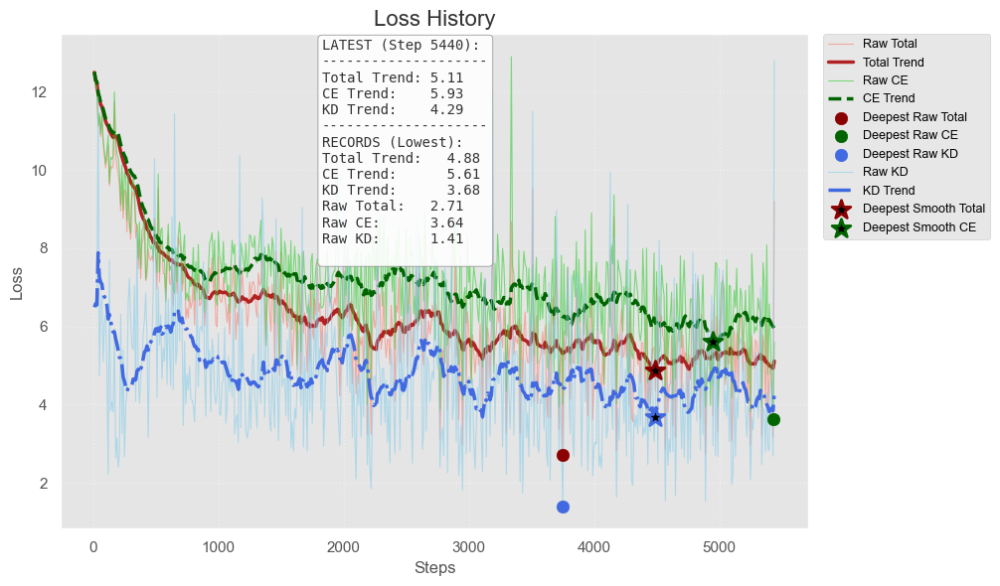

In [380]:
# Setup nice style
plt.style.use("ggplot")
fig, ax = plt.subplots(figsize=(12, 6))

# Data
steps = df["step"]
total_loss = df["total_loss"]
ce_loss = df["ce_loss"]
kd_loss = df["kd_loss"]

# Smoothing
smooth_window = 20
total_smooth = total_loss.rolling(window=smooth_window, min_periods=1).mean()
ce_smooth = ce_loss.rolling(window=smooth_window, min_periods=1).mean()
kd_smooth = kd_loss.rolling(window=smooth_window, min_periods=1).mean()

# --- PLOTTING ---

# 1. TOTAL LOSS
ax.plot(steps, total_loss, color="Salmon", alpha=0.6, label="Raw Total", linewidth=0.8)
ax.plot(steps, total_smooth, color="FireBrick", linewidth=2.5, label="Total Trend")

# 2. CE LOSS
ax.plot(steps, ce_loss, color="LimeGreen", alpha=0.6, label="Raw CE", linewidth=0.8)
ax.plot(
    steps, ce_smooth, color="DarkGreen", linewidth=2.5, linestyle="--", label="CE Trend"
)

# --- HIGHLIGHT: RAW MINIMUMS (DOTS) ---

# Total Raw
min_total_raw_idx = total_loss.idxmin()
ax.scatter(
    [steps[min_total_raw_idx]],
    [total_loss[min_total_raw_idx]],
    color="DarkRed",
    s=80,
    zorder=5,
    label="Deepest Raw Total",
)

# CE Raw
min_ce_raw_idx = ce_loss.idxmin()
ax.scatter(
    [steps[min_ce_raw_idx]],
    [ce_loss[min_ce_raw_idx]],
    color="DarkGreen",
    s=80,
    zorder=5,
    label="Deepest Raw CE",
)

min_kd_raw_idx = kd_loss.idxmin()
ax.scatter(
    [steps[min_kd_raw_idx]],
    [kd_loss[min_kd_raw_idx]],
    color="RoyalBlue",
    s=80,
    zorder=5,
    label="Deepest Raw KD",
)

# 3. KD LOSS
plt.plot(steps, kd_loss, color="SkyBlue", alpha=0.6, label="Raw KD", linewidth=0.8)
plt.plot(
    steps,
    kd_smooth,
    color="RoyalBlue",
    linewidth=2.5,
    linestyle="-.",
    label="KD Trend",
)


# --- HIGHLIGHT: SMOOTH MINIMUMS (STARS) ---

# Total Smooth
min_total_smooth_idx = total_smooth.idxmin()
val_total_smooth = total_smooth[min_total_smooth_idx]
step_total_smooth = steps[min_total_smooth_idx]

ax.scatter(
    [step_total_smooth],
    [val_total_smooth],
    color="black",
    edgecolor="DarkRed",
    marker="*",
    s=200,
    linewidth=2,
    zorder=6,
    label="Deepest Smooth Total",
)

# CE Smooth
min_ce_smooth_idx = ce_smooth.idxmin()
val_ce_smooth = ce_smooth[min_ce_smooth_idx]
step_ce_smooth = steps[min_ce_smooth_idx]

ax.scatter(
    [step_ce_smooth],
    [val_ce_smooth],
    color="black",
    edgecolor="DarkGreen",
    marker="*",
    s=200,
    linewidth=2,
    zorder=6,
    label="Deepest Smooth CE",
)


min_kd_smooth_idx = kd_smooth.idxmin()
val_kd_smooth = kd_smooth[min_kd_smooth_idx]
step_kd_smooth = steps[min_kd_smooth_idx]

plt.scatter(
    [step_kd_smooth],
    [val_kd_smooth],
    color="black",
    edgecolor="RoyalBlue",
    marker="*",
    s=200,
    linewidth=2,
    zorder=6,
    # label="Deepest Smooth KD",
)


# --- DASHBOARD BOX ---
props = dict(boxstyle="round", facecolor="white", alpha=0.9, edgecolor="gray")
stats_text = (
    f"LATEST (Step {steps.iloc[-1]}):\n"
    f"--------------------\n"
    # f"Total Raw:   {total_loss.iloc[-1]:.2f}\n"
    f"Total Trend: {total_smooth.iloc[-1]:.2f}\n"
    # f"CE Raw:      {ce_loss.iloc[-1]:.2f}\n"
    f"CE Trend:    {ce_smooth.iloc[-1]:.2f}\n"
    f"KD Trend:    {kd_smooth.iloc[-1]:.2f}\n"
    f"--------------------\n"
    f"RECORDS (Lowest):\n"
    f"Total Trend:   {total_smooth.min():.2f}\n"
    f"CE Trend:      {ce_smooth.min():.2f}\n"
    f"KD Trend:      {kd_smooth.min():.2f}\n"
    f"Raw Total:   {total_loss.min():.2f}\n"
    f"Raw CE:      {ce_loss.min():.2f}\n"
    f"Raw KD:      {kd_loss.min():.2f}\n"
)

ax.text(
    0.35,
    0.99,
    stats_text,
    transform=ax.transAxes,
    fontsize=10,
    verticalalignment="top",
    bbox=props,
    fontfamily="monospace",
    color="#333333",
)

# Styling
ax.set_title("Loss History", fontsize=16, color="#333333")
ax.set_xlabel("Steps", fontsize=12)
ax.set_ylabel("Loss", fontsize=12)
ax.grid(True, linestyle=":", alpha=0.4)
# ax.legend(loc="upper right", framealpha=0.9, fontsize=9, labelcolor="black")

plt.legend(
    loc="upper left",
    bbox_to_anchor=(1.02, 1),
    framealpha=0.9,
    fontsize=9,
    labelcolor="black",
    borderaxespad=0.0,
)
plt.tight_layout(rect=[0, 0, 0.85, 1])  # Make room for legend

# plt.tight_layout()
plt.show()

# LOSS TO PPL for CROSS Entropy (CE)

Perplexity is the "branching factor" - effective number of words the model is puzzled by.

$$ \text{PPL} = e^{\text{(CE Loss)}} $$

- **Loss 12.0** -> PPL 162,000 (Random guessing among total vocabulary).
- **Loss 7.0** -> PPL 1,096 (Confused, but knows it should be an English word).
- **Loss 5.0** -> PPL 148 (Knows the general topic, guessing between synonyms).
- **Loss 3.0** -> PPL 20 (Fluent English, very confident).
- **Loss 1.0** -> PPL 2.7 (Almost perfect prediction).


In [381]:
import matplotlib.animation as animation
from IPython.display import HTML
import matplotlib.pyplot as plt

# 1. Increase Embed Limit (to 50MB) + Auto-Reload
plt.rcParams["animation.embed_limit"] = 50.0

# Setup Figure
plt.style.use("ggplot")
fig, ax = plt.subplots(figsize=(12, 6))

# Fixed Y-axis (Estimated from data), Dynamic X
ax.set_xlim(df["step"].min(), df["step"].max())
y_min = min(df["ce_loss"].min(), df["total_loss"].min()) * 0.9
y_max = max(df["ce_loss"].max(), df["total_loss"].max()) * 1.05
ax.set_ylim(y_min, y_max)
ax.set_title("The Quantum Pit: Live Descent Animation", fontsize=16)
ax.set_xlabel("Steps")
ax.set_ylabel("Loss")
ax.grid(True, linestyle=":", alpha=0.4)

# Artists
(line_total_raw,) = ax.plot(
    [], [], color="Salmon", alpha=0.5, linewidth=0.8, label="Raw Total"
)
(line_total_smooth,) = ax.plot(
    [], [], color="FireBrick", linewidth=2.5, label="Total Trend"
)
(line_ce_raw,) = ax.plot(
    [], [], color="LimeGreen", alpha=0.5, linewidth=0.8, label="Raw CE"
)
(line_ce_smooth,) = ax.plot(
    [], [], color="DarkGreen", linewidth=2.5, linestyle="--", label="CE Trend"
)

scat_total_raw = ax.scatter([], [], color="DarkRed", s=80, zorder=5)
scat_ce_raw = ax.scatter([], [], color="DarkGreen", s=80, zorder=5)
scat_total_smooth = ax.scatter(
    [], [], color="white", edgecolor="DarkRed", marker="*", s=200, linewidth=2, zorder=6
)
scat_ce_smooth = ax.scatter(
    [],
    [],
    color="white",
    edgecolor="DarkGreen",
    marker="*",
    s=200,
    linewidth=2,
    zorder=6,
)

props = dict(boxstyle="round", facecolor="white", alpha=0.9, edgecolor="gray")
stats_text_artist = ax.text(
    0.65,
    0.99,
    "",
    transform=ax.transAxes,
    fontsize=10,
    verticalalignment="top",
    bbox=props,
    fontfamily="monospace",
    color="#333333",
)

ax.legend(loc="upper right", framealpha=0.9, fontsize=9)

# Data Prep
smooth_window = 20
df["total_smooth"] = (
    df["total_loss"].rolling(window=smooth_window, min_periods=1).mean()
)
df["ce_smooth"] = df["ce_loss"].rolling(window=smooth_window, min_periods=1).mean()


def update(frame):
    # Slice data up to current frame
    current_df = df.iloc[: frame + 1]
    if len(current_df) < 1:
        return []

    steps = current_df["step"]

    # Update Lines
    line_total_raw.set_data(steps, current_df["total_loss"])
    line_total_smooth.set_data(steps, current_df["total_smooth"])
    line_ce_raw.set_data(steps, current_df["ce_loss"])
    line_ce_smooth.set_data(steps, current_df["ce_smooth"])

    # Update Records
    idx_tr = current_df["total_loss"].idxmin()
    scat_total_raw.set_offsets([[steps[idx_tr], current_df["total_loss"][idx_tr]]])

    idx_cr = current_df["ce_loss"].idxmin()
    scat_ce_raw.set_offsets([[steps[idx_cr], current_df["ce_loss"][idx_cr]]])

    idx_ts = current_df["total_smooth"].idxmin()
    scat_total_smooth.set_offsets([[steps[idx_ts], current_df["total_smooth"][idx_ts]]])

    idx_cs = current_df["ce_smooth"].idxmin()
    scat_ce_smooth.set_offsets([[steps[idx_cs], current_df["ce_smooth"][idx_cs]]])

    # Text Update
    msg = (
        f"STEP: {steps.iloc[-1]}\n"
        f"--------------------\n"
        f"Raw Total:   {current_df['total_loss'].iloc[-1]:.2f}\n"
        f"Sm. Total:   {current_df['total_smooth'].iloc[-1]:.2f}\n"
        f"Raw CE:      {current_df['ce_loss'].iloc[-1]:.2f}\n"
        f"Sm. CE:      {current_df['ce_smooth'].iloc[-1]:.2f}\n"
        f"--------------------\n"
        f"RECORD LOWS:\n"
        f"Raw CE:      {current_df['ce_loss'].min():.2f}\n"
        f"Sm. CE:      {current_df['ce_smooth'].min():.2f}"
    )

    stats_text_artist.set_text(msg)

    return [
        line_total_raw,
        line_total_smooth,
        line_ce_raw,
        line_ce_smooth,
        scat_total_raw,
        scat_ce_raw,
        scat_total_smooth,
        scat_ce_smooth,
        stats_text_artist,
    ]


# OPTIMIZATION: Skip frames (e.g. every 5th step) to reduce size
# If len(df) > 1000, 1000 frames is heavy. Reducing by factor of 5 helps.
skip_factor = 5
frames_indices = range(0, len(df), skip_factor)

# Ensure the VERY LAST frame is included no matter what
if len(df) - 1 not in frames_indices:
    frames_indices = list(frames_indices) + [len(df) - 1]

# Create Animation (frames = how many steps, interval = speed in ms)
# Speed up by skipping frames if dataset is huge: frames=range(0, len(df), 5)
# ani = animation.FuncAnimation(fig, update, frames=len(df), interval=50, blit=True)
ani = animation.FuncAnimation(
    fig, update, frames=frames_indices, interval=30, blit=True
)
plt.close()  # Prevent double display of the static plot

HTML(ani.to_jshtml())  # Or ani.to_html5_video() if ffmpeg is installed

C:\Users\dpanc\AppData\Local\Temp\ipykernel_26036\1877583512.py:60: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


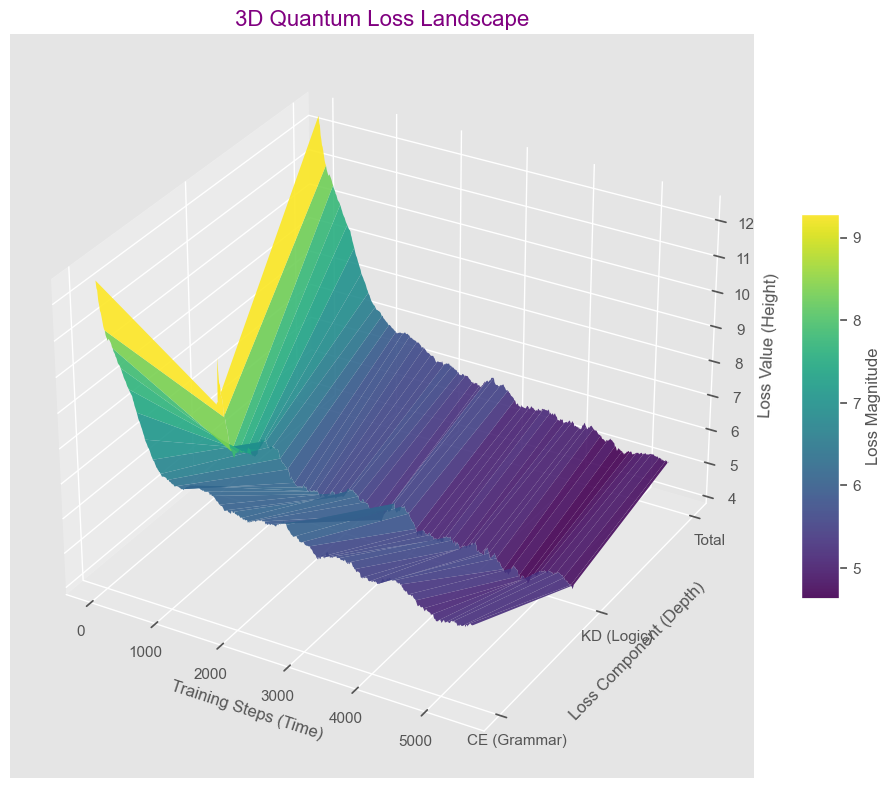

In [382]:
from matplotlib import cm


# 1. Prepare Data for 3D Surface
# X = Steps
# Y = Loss Type Index (0=CE, 1=KD, 2=Total) - Creating depth separation
# Z = Loss Value

# Smooth the data for a nice surface
window = 50
df["ce_smooth"] = df["ce_loss"].rolling(window=window, min_periods=1).mean()
# Handle 'kd_loss' column (might be 'mag_loss' in older rows)
kd_col = "kd_loss" if "kd_loss" in df.columns else "mag_loss"
# Fill NaNs if mixed
if kd_col not in df.columns and "mag_loss" in df.columns:
    kd_col = "mag_loss"
df["kd_smooth"] = df[kd_col].rolling(window=window, min_periods=1).mean()
df["total_smooth"] = df["total_loss"].rolling(window=window, min_periods=1).mean()

# Create meshgrid
steps = df["step"].values
loss_types = np.array([0, 1, 2])  # 0: CE, 1: KD, 2: Total
X, Y = np.meshgrid(steps, loss_types)

# Construct Z Matrix (Rows = Loss Types, Cols = Steps)
# We limit to min length to match
Z = np.array(
    [
        df["ce_smooth"].values,  # Y=0 Front
        df["kd_smooth"].values,  # Y=1 Middle
        df["total_smooth"].values,  # Y=2 Back
    ]
)

# Plotting
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection="3d")

# Plot Surface
surf = ax.plot_surface(
    X, Y, Z, cmap=cm.viridis, edgecolor="none", alpha=0.9, antialiased=True
)

# Styling
ax.set_title("3D Quantum Loss Landscape", fontsize=16, color="purple")
ax.set_xlabel("Training Steps (Time)", fontsize=12)
ax.set_ylabel("Loss Component (Depth)", fontsize=12)
ax.set_zlabel("Loss Value (Height)", fontsize=12)

# Y-Axis Labels
ax.set_yticks([0, 1, 2])
ax.set_yticklabels(["CE (Grammar)", "KD (Logic)", "Total"])

# Add Color Bar
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=10, label="Loss Magnitude")

# Rotation for best view
ax.view_init(elev=30, azim=-60)

plt.tight_layout()
plt.show()

Monitoring: ../runs\IndraV11-GPUDistill-Llama_20251219-130308


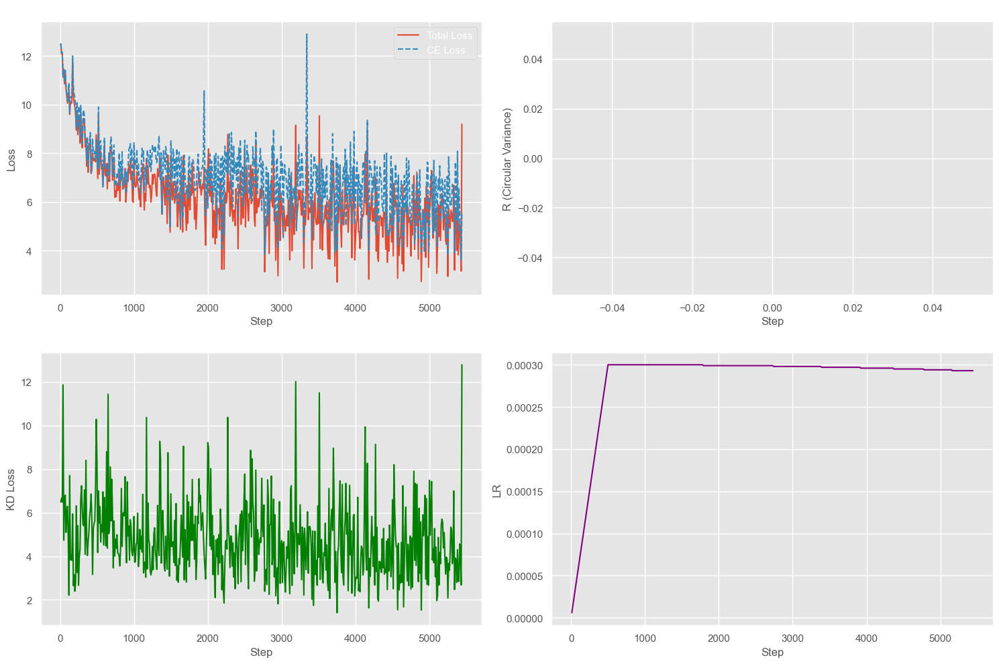

In [383]:
def plot_metrics(df):
    if df is None or len(df) == 0:
        return

    fig, axes = plt.subplots(2, 2, figsize=(15, 10))

    # Loss
    sns.lineplot(data=df, x="step", y="total_loss", ax=axes[0, 0], label="Total Loss")
    sns.lineplot(
        data=df, x="step", y="ce_loss", ax=axes[0, 0], label="CE Loss", linestyle="--"
    )
    axes[0, 0].set_title("Training Loss")
    axes[0, 0].set_xlabel("Step")
    axes[0, 0].set_ylabel("Loss")
    axes[0, 0].legend()

    # Phase Clustering (R)
    sns.lineplot(data=df, x="step", y="phase_loss", ax=axes[0, 1], color="orange")
    axes[0, 1].set_title("Phase Clustering (R)")
    axes[0, 1].set_xlabel("Step")
    axes[0, 1].set_ylabel("R (Circular Variance)")

    # Magnitude Regulation (M)
    sns.lineplot(data=df, x="step", y="kd_loss", ax=axes[1, 0], color="green")
    axes[1, 0].set_title("KD Regulation")
    axes[1, 0].set_xlabel("Step")
    axes[1, 0].set_ylabel("KD Loss")

    # Learning Rate
    sns.lineplot(data=df, x="step", y="lr", ax=axes[1, 1], color="purple")
    axes[1, 1].set_title("Learning Rate")
    axes[1, 1].set_xlabel("Step")
    axes[1, 1].set_ylabel("LR")

    plt.tight_layout()
    plt.show()

    # Real-time Loop


try:
    # while True:
    clear_output(wait=True)
    df = get_latest_run_metrics()
    plot_metrics(df)
    # time.sleep(30)  # Refresh every 30s
except KeyboardInterrupt:
    print("Stopped Monitoring.")